### Introduction

Our intention is to generate sound from a random generated  piano roll and various SoundFonts, and than train a network to do the inverse problem, i.e to detect the pitches of a guitar melody. 




The code is not intended to be clean and quite some hacky stuff are happening (Largely due to the fact that the time -> frequency conversion was initially done by a separate class, but now the network itself is doing the transformation.)

Some files ( as noises and soundfonts) are loaded from my private Google Drive.

noises from here:
http://www.orangefreesounds.com/background-noise-sound-pack/
http://www.orangefreesounds.com/rain-sounds-sound-pack/


In [0]:
!pip install  pyfluidsynth

In [0]:
!apt-get install fluidsynth

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  fluid-soundfont-gm libfluidsynth1 libqt5x11extras5 qsynth
Suggested packages:
  fluid-soundfont-gs timidity jackd
The following NEW packages will be installed:
  fluid-soundfont-gm fluidsynth libfluidsynth1 libqt5x11extras5 qsynth
0 upgraded, 5 newly installed, 0 to remove and 8 not upgraded.
Need to get 120 MB of archives.
After this operation, 150 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 fluid-soundfont-gm all 3.1-5.1 [119 MB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libfluidsynth1 amd64 1.1.9-1 [137 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic/universe amd64 fluidsynth amd64 1.1.9-1 [20.7 kB]
Get:4 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libqt5x11extras5 amd64 5.9.5-0ubuntu1 [8,596 B]
Get:5 http://archive.ubuntu.com/ubuntu bionic/univ

In [0]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/gdrive


In [0]:
!mkdir BackgroundNoise
!cp /content/gdrive/My\ Drive/BackgroundNoise/*.zip BackgroundNoise/
!unzip -o "BackgroundNoise/*.zip" -d BackgroundNoise/unzipped
!find ./BackgroundNoise/unzipped/ -name '*.wav' -exec cp '{}' ./BackgroundNoise/unzipped \;
!find ./BackgroundNoise/unzipped/ -name '*.mp3' -exec cp '{}' ./BackgroundNoise/unzipped \;

!ls BackgroundNoise/unzipped



Archive:  BackgroundNoise/Rain-sounds.zip
  inflating: BackgroundNoise/unzipped/Rain-sound-1.wav  
  inflating: BackgroundNoise/unzipped/Rain-sound-10.wav  
  inflating: BackgroundNoise/unzipped/Rain-sound-11.wav  
  inflating: BackgroundNoise/unzipped/Rain-sound-12.wav  
  inflating: BackgroundNoise/unzipped/Rain-sound-2.wav  
  inflating: BackgroundNoise/unzipped/Rain-sound-3.wav  
  inflating: BackgroundNoise/unzipped/Rain-sound-4.wav  
  inflating: BackgroundNoise/unzipped/Rain-sound-5.wav  
  inflating: BackgroundNoise/unzipped/Rain-sound-6.wav  
  inflating: BackgroundNoise/unzipped/Rain-sound-7.wav  
  inflating: BackgroundNoise/unzipped/Rain-sound-8.wav  
  inflating: BackgroundNoise/unzipped/Rain-sound-9.wav  
  inflating: BackgroundNoise/unzipped/Read.txt  

Archive:  BackgroundNoise/Background-noise-sound-pack.zip
  inflating: BackgroundNoise/unzipped/Birds-noise.wav  
  inflating: BackgroundNoise/unzipped/Cricket-noise.wav  
  inflating: BackgroundNoise/unzipped/Fan-noise.w

In [0]:
import numpy as np
from IPython.display import Audio
from IPython.display import Image
import matplotlib.pyplot as plt
%matplotlib inline  

from scipy.io import wavfile
from scipy import signal
import scipy

import librosa

from sklearn.model_selection import train_test_split


import time
import numpy
import fluidsynth
import datetime

import os 
from shutil import copyfile
from IPython.core.debugger import set_trace

import seaborn as sns; sns.set()
import random
%load_ext tensorboard
from tensorflow import summary
from keras.callbacks import TensorBoard



import tensorflow as tf
import keras
from keras.models import Model
from keras.layers import * 
from keras.utils import plot_model 
from keras import optimizers

import keras.backend as K
from keras.models import load_model



from tqdm import tqdm



The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [0]:
sampleRate = 44100

seed = 2005

np.random.seed(seed)
tf.set_random_seed(seed)

In [0]:
class NoiseGenerator:
  def __init__(self, noiseFiles, sampleRate, mean_volume = 0.3 , sigma_volume = 0.2):
    self.mean_volume = mean_volume
    self.sigma_volume = sigma_volume
    if noiseFiles is None or len(noiseFiles) == 0:
      self.noises = None
    else:
      self._loadNoises(noiseFiles)
    self.lastNoiseVolume = mean_volume
      
  def _loadNoises(self, noiseFiles):
    self.noises = []
    for noiseFile in noiseFiles:
      if not os.path.isfile(noiseFile):
        raise Exception("File not found " , noiseFile)
      self.noises.append(librosa.core.load(noiseFile, sr = sampleRate)[0])
      print("Loaded noise " , noiseFile)
    self.numNoises = len(self.noises)
    self._changeNoise()
    
  def _changeNoise(self):
    self.currentNoise = self.noises[random.randint(0,self.numNoises-1)]
    self.currentNoiseLength = len(self.currentNoise)
    self.currentPos = 0
    
  
  def _getNewNoiseVolume(self):
    return np.random.normal(self.mean_volume, self.sigma_volume,1)
  
  def getNoise(self, sampleLength):
    
    result = np.zeros((sampleLength))
    if self.noises is None : return result
    
    filled = 0
    while filled < sampleLength:
      remainingNoiseLength = self.currentNoiseLength - self.currentPos
      if remainingNoiseLength + filled < sampleLength:
        result[filled: remainingNoiseLength + filled ] = self.currentNoise[self.currentPos:]
        self._changeNoise()
        filled = filled + remainingNoiseLength
      else:
        result[filled :] = self.currentNoise[self.currentPos : self.currentPos + sampleLength - filled]
        self.currentPos = self.currentPos + sampleLength - filled
        filled = sampleLength
                
    newNoiseVolume = self._getNewNoiseVolume()
    noiseVolumeVector = np.linspace(self.lastNoiseVolume, newNoiseVolume, sampleLength)
    self.lastNoiseVolume = newNoiseVolume
    
    result = result.reshape(sampleLength,1) * noiseVolumeVector.reshape(sampleLength,1)
    assert(result.shape == (sampleLength,1))
    return result
      
        
    
    
      
    

In [0]:
noiseGenerator = NoiseGenerator(["./BackgroundNoise/unzipped/People-talking-noise.wav"], 44100,  sigma_volume = 1)
noise = noiseGenerator.getNoise(12 * 44100)

Audio(np.reshape(noise, (np.prod(noise.shape),)), rate = 44100)


Loaded noise  ./BackgroundNoise/unzipped/People-talking-noise.wav


In [0]:
class musicGenerator:
  def __init__(self, sampleRate, notechangeToBPMRatio = 0.5, \
               lowestMidiNum = 40, highestMidiNum = 82,\
               polyphony = 3):
    self.synth = None
    self.loadedSoundFont = None
    self.sampleRate = sampleRate
    self.defaultSoundFontPath =  os.path.join("/content","gdrive","My Drive", "SoundFonts" , "Acoustic Guitar.sf2")
    self.notechangeToBPMRatio = notechangeToBPMRatio
    self.lowestMidiNum = lowestMidiNum
    self.highestMidiNum = highestMidiNum
    self.polyphony = polyphony # number of notes allowed to be played together.
    self.delSynth()
    self.soundFontLibrary = {}
    
    
  def assureSynthReady(self, soundFontPath):
    if soundFontPath not in self.soundFontLibrary and not os.path.isfile(soundFontPath):
      raise Exception("File not found " , soundFontPath)
    synthCreated = False
    if self.synth is None:
      synthCreated = True
      self.synth = fluidsynth.Synth(samplerate = self.sampleRate)
    if self.loadedSoundFontPath is None or self.loadedSoundFontPath != soundFontPath:
      #print("Loading font" , soundFontPath)
      if soundFontPath in self.soundFontLibrary:
        soundFont = self.soundFontLibrary[soundFontPath]
      else:
        soundFont = self.synth.sfload(soundFontPath)
        self.soundFontLibrary[soundFontPath] = soundFont      
      self.loadedSoundFont = soundFont
      self.synth.program_select(0, self.loadedSoundFont, 0, 0)
      self.loadedSoundFontPath = soundFontPath
    if synthCreated:
      for note in self.currentNotes:
        self.synth.noteon(0, note, self.getVelocity(note))
      
  
  def delSynth(self):
    if self.synth is not None:
      self.synth.delete()
      self.synth = None
    self.loadedSoundFont = None  
    self.loadedSoundFontPath = None
    self.currentNotes = self.getRandomNoteArray(self.polyphony)
    self.lastNoteChangeTimeInSamples = 0 
    
  def bpmToLength(self, bpm):
    return 60/bpm * self.sampleRate
  
  def getRandomNoteArray(self, numNotes):
    return np.random.randint(self.lowestMidiNum, self.highestMidiNum+1, numNotes)
    
  
  def getNoteChangeProbability(self, note):
    return 0.75
  
  def getNoteRemoveProbability(self, note):
    return 0.5
  
  def getAddingNewNoteProbability(self, notes):
    return 0.5 if len(notes) == 0 else 0.1
  
  def getNumberOfAddedNotes(self, notes):
    return max(min(1,int((self.polyphony - len(notes)) * np.random.rand() )), self.polyphony - len(notes))
  
  def getChangedNote(self, oldNote):
    newNote = self.getRandomNoteArray(1)[0]
    return newNote if newNote != oldNote else self.getChangedNote(oldNote)
  
  def getAddedNotes(self, notes):
    newNotes = self.getRandomNoteArray(self.getNumberOfAddedNotes(notes))
    return newNotes if len(set(notes).intersection(set(newNotes))) == 0 else self.getAddedNotes(notes)
  
  def getVelocity(self, note):
    return int(69 + np.random.rand() * 50)
  
    
    
    
  
  def changeNotes(self):
    self.lastNoteChangeTimeInSamples = 0
    newNotes = np.asarray([],dtype=int)
    for note in self.currentNotes:
      if self.getNoteChangeProbability(note) > np.random.rand(): # deciding to change or mute the note
        self.synth.noteoff(0, note)
        if self.getNoteRemoveProbability(note) <=  np.random.rand(): # not removing the note but changing 
          newNote = self.getChangedNote(note)
          newNotes = np.append(newNotes,newNote)
          self.synth.noteon(0, newNote, self.getVelocity(newNote))
      else:
        newNotes = np.append(newNotes, note)
          
    
    if len(newNotes) < self.polyphony and self.getAddingNewNoteProbability(newNotes) > np.random.rand():
      addedNotes = self.getAddedNotes(newNotes)
      for note in addedNotes:
        self.synth.noteon(0, note, self.getVelocity(note))
      newNotes = np.append(newNotes,addedNotes)    
    self.currentNotes = newNotes
      
  def notesToPianoRoll(self, notes):
    pianoRoll = np.zeros(self.highestMidiNum - self.lowestMidiNum + 1, dtype=int)
    for note in notes:
      pianoRoll[note - self.lowestMidiNum] = 1
    numNotes = np.zeros(self.polyphony +1 , dtype = int)
    numNotes[len(set(notes))] = 1
    return (pianoRoll, numNotes) # one-hot encoded vectors        
      
    
  def getMusicWithMidiNum(self, sampleLength = 512, bpm = 120,  soundFontPath = None):
    if soundFontPath is None:
      soundFontPath = self.defaultSoundFontPath
    self.assureSynthReady(soundFontPath)
    nextNoteChangeInSamples =  int(self.bpmToLength(self.notechangeToBPMRatio * bpm)) - self.lastNoteChangeTimeInSamples
    if nextNoteChangeInSamples > sampleLength: # no need to change notes in this sqequence
      result =  (self.synth.get_samples(sampleLength)[::2] , self.currentNotes) # converting stereo to mono
      self.lastNoteChangeTimeInSamples = self.lastNoteChangeTimeInSamples + sampleLength
    else:
      (oldResult, oldNotes) = (self.synth.get_samples(nextNoteChangeInSamples)[::2] , self.currentNotes)
      self.changeNotes()      
      (newResult, newNotes) = self.getMusicWithMidiNum(sampleLength - nextNoteChangeInSamples, bpm,soundFontPath )
      if nextNoteChangeInSamples > sampleLength - nextNoteChangeInSamples :
        notes = oldNotes
      else:
        notes = newNotes
      result = (np.append(oldResult, newResult) , notes)
        
    return result     
  
  def getMusicWithOnehotEncodedMidiNum(self, sampleLength = 512, bpm = 120,  soundFontPath = None):
    (music, notes) = self.getMusicWithMidiNum(sampleLength, bpm, soundFontPath)
    assert(len(music.shape) == 1 or music.shape[1] == 1)
    (pianoRoll, numNotes) = self.notesToPianoRoll(notes)
    return (music.reshape(1,-1).transpose(), pianoRoll, numNotes)
  
    

In [0]:
class MusicFilter:
  
  def __init__(self, sampleRate, lowPassFreq = 1000, highPassFreq = 8000, order = 5):
    #https://stackoverflow.com/questions/12093594/how-to-implement-band-pass-butterworth-filter-with-scipy-signal-butter
    #https://scipy.github.io/old-wiki/pages/Cookbook/ButterworthBandpass
    #https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.butter.html
    
    
    self.lowPassFreq = lowPassFreq
    self.highPassFreq = highPassFreq
    self.sampleRate = sampleRate
    nyq = sampleRate/2
    self.sos = signal.butter(order,[lowPassFreq / nyq , highPassFreq / nyq] , analog = False,  btype = "band", output = "sos")
  def filter(self, music):
    return signal.sosfilt(self.sos, music, axis = 0)
  
  def plotTransferFunction(self):
    w, h = signal.sosfreqz(self.sos)
    plt.semilogx(w * self.sampleRate /2/np.pi, 20 * np.log10(abs(h)))
    plt.title('Butterworth filter frequency response')
    plt.xlabel('Frequency [Hz]')
    plt.ylabel('Amplitude [dB]')
    plt.margins(0, 0.1)
    plt.grid(which='both', axis='both')
    plt.axvline(self.lowPassFreq, color='green') # cutoff frequency
    plt.axvline(self.highPassFreq, color='green') # cutoff frequency
    plt.show()

    

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:19: RuntimeWarning: divide by zero encountered in log10


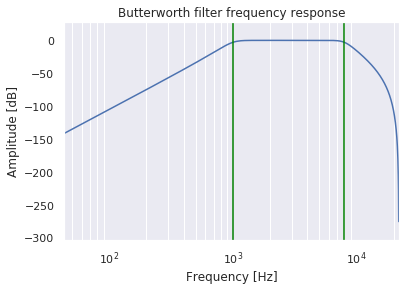

In [0]:
 a = MusicFilter(44100)
 a.plotTransferFunction()

In [0]:
class FreqTransformator:
  
  def transform(music):
    return music # todo: write Code

In [0]:
class FFTTransformator(FreqTransformator):
  
  def transform(music):
    freqs = abs(np.fft.rfft(music))
    freqs = freqs - np.min(freqs)
    if np.max(freqs) > 0.000000000000001:
      freqs = freqs / np.max(freqs)
      freqs = freqs / np.std(freqs)
    #return freqs
    return freqs[0:50]

In [0]:
class TrainGenerator():
  
  def __init__(self, musicFilter, freqTransformator, sampleRate = 44100,\
               sampleLength = 512, lowestMidiNum = 40, highestMidiNum = 82,\
               polyphony = 3, notechangeToBPMRatio = 1,  bpms = [120],\
               bpmChangeInSec = 60*10,\
               soundFonts = [os.path.join("/content","gdrive","My Drive", "SoundFonts" , "Acoustic Guitars JNv2.4.sf2")],\
               soundFontChangeInSec = 60*5,
              noisePaths =  ["./BackgroundNoise/unzipped/People-talking-noise.wav"],
              mean_noise_volume = 0.3 , sigma_noise_volume = 0.2):
    self.sampleRate = sampleRate
    self.musicFilter = musicFilter
    self.freqTransformator = freqTransformator
    self.sampleLength = sampleLength
    self.generator = musicGenerator(sampleRate, notechangeToBPMRatio, lowestMidiNum = lowestMidiNum,highestMidiNum = highestMidiNum, polyphony = polyphony )
    self.bpms = bpms
    self.bpmChangeInSec = bpmChangeInSec
    self.soundFonts = soundFonts
    self.soundFontChangeInSec = soundFontChangeInSec
    self.bpmChangedInSecAgo = 0
    self.soundFontChangedInSecAgo = 0
    self.soundFontUsed = random.choice(soundFonts)
    self.bpmUsed = random.choice(bpms)
    self.noiseGenerator = NoiseGenerator(noisePaths, sampleRate, mean_noise_volume, sigma_noise_volume)


  def checkSoundFontChage(self, secsEslaped):
    self.soundFontChangedInSecAgo = self.soundFontChangedInSecAgo + secsEslaped
    if self.soundFontChangedInSecAgo >= self.soundFontChangeInSec:
      self.soundFontUsed = random.choice(self.soundFonts)
      self.soundFontChangedInSecAgo = 0
  
  def checkBpmChange(self, secsEslaped):
    self.bpmChangedInSecAgo = self.bpmChangedInSecAgo + secsEslaped
    if self.bpmChangedInSecAgo >= self.bpmChangeInSec:
      self.bpmUsed = random.choice(self.bpms)
      
  def sampleToSec(self, numSamples):
    return numSamples / self.sampleRate
  
  def getSingleMusicSample(self):
      (music,pianoRoll, numNotes)  = self.generator.getMusicWithOnehotEncodedMidiNum(self.sampleLength, soundFontPath = self.soundFontUsed)
      noise = self.noiseGenerator.getNoise(self.sampleLength)
      assert(noise.shape == music.shape)
      return (music + noise , pianoRoll, numNotes)
      
    
  def getMusicSample(self, duration, doFilter = True):
    stepsNeeded = int(np.ceil(duration * self.sampleRate / self.sampleLength))
    
    result = numpy.zeros((stepsNeeded * self.sampleLength,1))
    for i in range(stepsNeeded):
      (music,pianoRoll, numNotes) = self.getSingleMusicSample()
      result[i*self.sampleLength : (i+1) * self.sampleLength,:] = music
    if doFilter:
      return self.musicFilter.filter(result)
    else:
      return result
  
  def getSingleSample(self):
      (music,pianoRoll, numNotes) = self.getSingleMusicSample()
      music = self.musicFilter.filter(music)
      freqDomain = self.freqTransformator.transform(music)
      return (freqDomain , pianoRoll , numNotes)

    
  
  def generate(self, batchSize = 1, sequenceSize = 1, returnNumNotes = True):
    (singleMusic,singlePianoRoll, singleNumNotes) = self.getSingleMusicSample()
    singleFreqs = self.freqTransformator.transform(singleMusic)
        
    while True:
    
      music = np.zeros((batchSize, sequenceSize, len(singleMusic)))
      freqs = np.zeros((batchSize, sequenceSize, len(singleFreqs)), dtype = singleFreqs.dtype)
      pianoRoll = np.zeros((batchSize, sequenceSize, len(singlePianoRoll)), dtype = singlePianoRoll.dtype)
      numNotes = np.zeros((batchSize, sequenceSize, len(singleNumNotes)), dtype = singleNumNotes.dtype)

      for b in range(batchSize):
        for s in range(sequenceSize):
          (singleMusic, singlePianoRoll, singleNumNotes) = self.getSingleMusicSample()
          music[b,s,:] = singleMusic.reshape(-1,)
          pianoRoll[b,s,:] = singlePianoRoll
          numNotes[b,s,:] = singleNumNotes
        music[b,:,:] = self.musicFilter.filter(np.squeeze(music[b,:,:].reshape(sequenceSize * len(singleMusic),))).reshape(sequenceSize, -1)
        for s in range(sequenceSize):
          freqs[b,s,:] = self.freqTransformator.transform(np.squeeze(music[b,s,:]))
        self.checkBpmChange(self.sampleToSec(self.sampleLength * sequenceSize))
        self.checkSoundFontChage(self.sampleToSec(self.sampleLength * sequenceSize))
      if returnNumNotes:    
        yield freqs, [pianoRoll, numNotes]
      else:
        yield freqs, pianoRoll
      
      
      
      
      
      

In [0]:
soundFontFolder = "/content/gdrive/My Drive/SoundFonts"

soundFonts = []

for file in os.listdir(soundFontFolder):
    if file.lower().endswith(".sf2"):
      soundFonts.append(os.path.join(soundFontFolder,file))
      
      
print(len(soundFonts),  "soundFonts found in total")
invalidSoundFonts = set()
      
print("checking soundfonts")
m = []
for sf in soundFonts:
  mm = []
  for i in range(40,83):      
    synth = fluidsynth.Synth(samplerate = 44100)
    synth.program_select(0, synth.sfload(sf), 0, 0)
    synth.noteon(0, i, 110)
    m1 = synth.get_samples(4410)[::2]
    synth.delete()
    if np.linalg.norm(m1) < 10000:
      invalidSoundFonts.add(sf)
    mm.append(m1)
  if sf not in invalidSoundFonts:
    for mm_part in mm:
      m.append(mm_part)
    print(sf)    

  
  
soundFonts = list(set(soundFonts) - invalidSoundFonts )
print(len(soundFonts), "are valid.")

Audio(np.reshape(np.concatenate(m), (-1,)), rate = 44100)




  


32 soundFonts found in total
checking soundfonts
/content/gdrive/My Drive/SoundFonts/Acoustic Guitar.sf2
/content/gdrive/My Drive/SoundFonts/Guitar Distortion.SF2
/content/gdrive/My Drive/SoundFonts/1115-JazzMelodic.sf2
/content/gdrive/My Drive/SoundFonts/Dsix Magic.sf2
/content/gdrive/My Drive/SoundFonts/Energized.sf2
/content/gdrive/My Drive/SoundFonts/Gibson Les Paul.sf2
/content/gdrive/My Drive/SoundFonts/Jazz Guitar.sf2
/content/gdrive/My Drive/SoundFonts/Stratocaster Light Overdrive.SF2
/content/gdrive/My Drive/SoundFonts/Stratocaster VS.sf2
/content/gdrive/My Drive/SoundFonts/Valve OD GTR VSx.sf2
/content/gdrive/My Drive/SoundFonts/VL-1 Eguitar VS.sf2
/content/gdrive/My Drive/SoundFonts/Voxline Session.sf2
/content/gdrive/My Drive/SoundFonts/459-GuitarSetPasisHeavyAndClean.sf2
/content/gdrive/My Drive/SoundFonts/463-Jazz Guitar.sf2
/content/gdrive/My Drive/SoundFonts/754-Donnys Guitar.SF2
/content/gdrive/My Drive/SoundFonts/1965 Harmony Rocket.sf2
/content/gdrive/My Drive/SoundF

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:19: RuntimeWarning: divide by zero encountered in log10


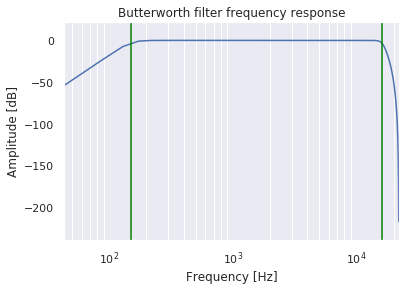

Loaded noise  ./BackgroundNoise/unzipped/People-talking-noise.wav


In [0]:
sampleRate = 44100

musicFilter = MusicFilter(sampleRate, lowPassFreq = 150, highPassFreq = 16000, order = 5)
musicFilter.plotTransferFunction()

doFFT = False

trainGenerator = TrainGenerator(musicFilter, (FreqTransformator if not doFFT else FFTTransformator), sampleRate = sampleRate, sampleLength = 512, lowestMidiNum = 40, highestMidiNum = 80, \
                               mean_noise_volume = 1000 , sigma_noise_volume = 200, \
                               soundFontChangeInSec = 20, soundFonts = soundFonts)

music = trainGenerator.getMusicSample(10, False)

freqs, outputs = next(trainGenerator.generate(batchSize = 60, sequenceSize = int(44100/512)))
(pianoRoll, numNotes) = outputs


In [0]:
np.squeeze(music).shape

(441344,)

In [0]:
Audio(np.reshape(music, (-1,)), rate = sampleRate)

In [0]:
Audio(np.reshape(musicFilter.filter(music), (-1,)), rate = sampleRate)  

In [0]:
if not doFFT:
  print("Freqs has music in it as FFT is skipped in preprocessing")
Audio(np.reshape(freqs, (-1,)), rate = sampleRate)

Freqs has music in it as FFT is skipped in preprocessing


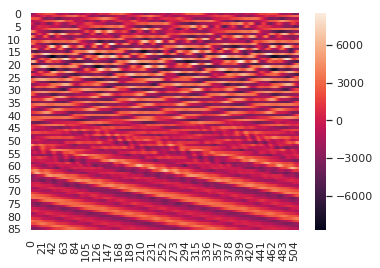

In [0]:
sns.heatmap(np.squeeze(freqs[0,:,:]))

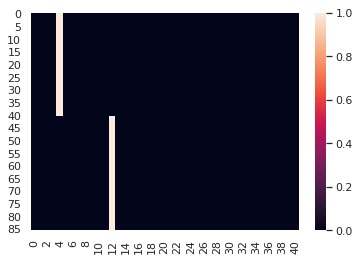

In [0]:
sns.heatmap(np.squeeze(pianoRoll[0,:,:]))

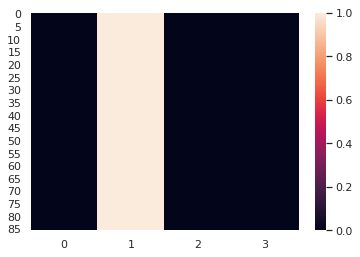

In [0]:
sns.heatmap(np.squeeze(numNotes[0,:,:]))

In [0]:
sampleSize = 100
sampleLength = 512
batchSize = int (60 * sampleRate / sampleLength / sampleSize)   # 1 minute of music in a packet

lowestMidiNum = 40
highestMidiNum = 82
polyphony = 1 #3

mean_noise_volume = 1000 
sigma_noise_volume = 200 


trainSoundfonts, validationSoundFonts = train_test_split(soundFonts, test_size=0.2, random_state=42)

print("There are " ,  len(trainSoundfonts) , " training soundfonts and " , len(validationSoundFonts) , " validation soundfonts.")


trainGenerator = TrainGenerator(MusicFilter(sampleRate), (FFTTransformator if doFFT else FreqTransformator),\
                                soundFonts = trainSoundfonts, soundFontChangeInSec = 20, \
                                sampleRate = sampleRate, sampleLength = sampleLength,\
                                lowestMidiNum = lowestMidiNum, highestMidiNum = highestMidiNum,\
                                polyphony = polyphony,\
                               mean_noise_volume = mean_noise_volume, sigma_noise_volume = sigma_noise_volume)

validationGenerator = TrainGenerator(MusicFilter(sampleRate), (FFTTransformator if doFFT else FreqTransformator),\
                                soundFonts = validationSoundFonts, soundFontChangeInSec = 20, \
                                sampleRate = sampleRate, sampleLength = sampleLength,\
                                lowestMidiNum = lowestMidiNum, highestMidiNum = highestMidiNum,\
                                polyphony = polyphony,\
                               mean_noise_volume = mean_noise_volume, sigma_noise_volume = sigma_noise_volume)


There are  16  training soundfonts and  4  validation soundfonts.
Loaded noise  ./BackgroundNoise/unzipped/People-talking-noise.wav
Loaded noise  ./BackgroundNoise/unzipped/People-talking-noise.wav


In [0]:
## Building model based on the jazz impro course.
#
#LSTM_units = 43*2
#
#reshapor = Reshape((1, len(input)))                        
#LSTM_cell = LSTM(LSTM_units, return_state = True)         
#densor = Dense(len(pianoRollOutput), activation='sigmoid')


#X = Input(batch_shape = (batchSize, sampleSize, len(input)))
#a0 = Input(shape=(LSTM_units,), name='a0')
#c0 = Input(shape=(LSTM_units,), name='c0')

#a = a0
#c = c0

#outputs = []

#for t in range(sampleSize):
#  x = Lambda(lambda x: x[:,t,:])(X)
#  x = reshapor(x)
#  a, _, c = LSTM_cell(x, initial_state = [c,a])
#  out = densor(a)
#  outputs.append(out)
#model = Model(inputs=[X, a0, c0], outputs=outputs)
#model.compile(loss=pianoRollLoss, metrics=["categorical_accuracy" ], optimizer= optimizers.Adam(lr=lr))
#
#
#plot_model(model, show_shapes=True, show_layer_names=True, to_file='model.png')
#Image(retina=True, filename='model.png')

polyphony = 1 : 

lr = 0.01 -> exact percentrage is above 50% after  the 5th epoch. abova 80% after the 8th epoch above 90% after the 10th epoch


polyphony = 1 + 1000Hz cut off freq:
lr = 0.01 -> exact percentage is above 50% after the 6th epoch. abive 80% after the 8th epoch above 90% after the 10th epoch


polyphony = 1 + 1000 Hz cutoff + noise
lr = 0.01 -> extact percentage is above 50% after 7th epoch. 

In [0]:

validation_data = []
for i in tqdm(range(50)):
  validation_data.append(next(validationGenerator.generate(batchSize, sampleSize, returnNumNotes = False)))

100%|██████████| 50/50 [00:55<00:00,  1.08s/it]


In [0]:
print(validation_data[0][0].shape)

validation_data_labels = np.concatenate([validation_data[i][1] for i in range(len(validation_data))])
validation_data_data = np.concatenate([validation_data[i][0] for i in range(len(validation_data))])
del validation_data

(51, 100, 512)


In [0]:

#sess = tf.Session()
#validation_data_ffts = tf.abs(tf.signal.rfft( tf.convert_to_tensor(validation_data_data, dtype=tf.float32 ))).eval(session=sess)
#print(validation_data_ffts.shape)

In [0]:
train_data = []
for i in tqdm(range(200)):
  train_data.append(next(trainGenerator.generate(batchSize, sampleSize, returnNumNotes = False)))


100%|██████████| 200/200 [04:06<00:00,  1.15s/it]


In [0]:
train_data[0][0].shape

(51, 100, 512)

In [0]:
train_data_labels = np.concatenate([train_data[i][1] for i in range(len(train_data))])
train_data_data = np.concatenate([train_data[i][0] for i in range(len(train_data))])

del train_data

print("train_data_data shape " , train_data_data.shape)
print("train_data_labels shape " , train_data_labels.shape)

train_data_data shape  (10200, 100, 512)
train_data_labels shape  (10200, 100, 43)


In [0]:
### in the browser this is ~1  !!!! TODO this is not too scientific bro.
np.max(train_data_data)
train_data_data = train_data_data / np.max(train_data_data)
validation_data_data = validation_data_data / np.max(validation_data_data)

In [0]:
print("This percent of the data is empty ( no sound) " , 100 - 100 * np.mean(np.sum(train_data_labels, -1) > 0))

This percent of the data is empty ( no sound)  27.432647058823534


Will be saved as logs/tensorboard/20190831_18_29_11
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            (None, 100, 512)     0                                            
__________________________________________________________________________________________________
real_fft (Dense)                (None, 100, 121)     61952       input_2[0][0]                    
__________________________________________________________________________________________________
imag_fft (Dense)                (None, 100, 121)     61952       input_2[0][0]                    
__________________________________________________________________________________________________
batch_normalization_3 (BatchNor (None, 100, 121)     484         real_fft[0][0]                   
________________________________________

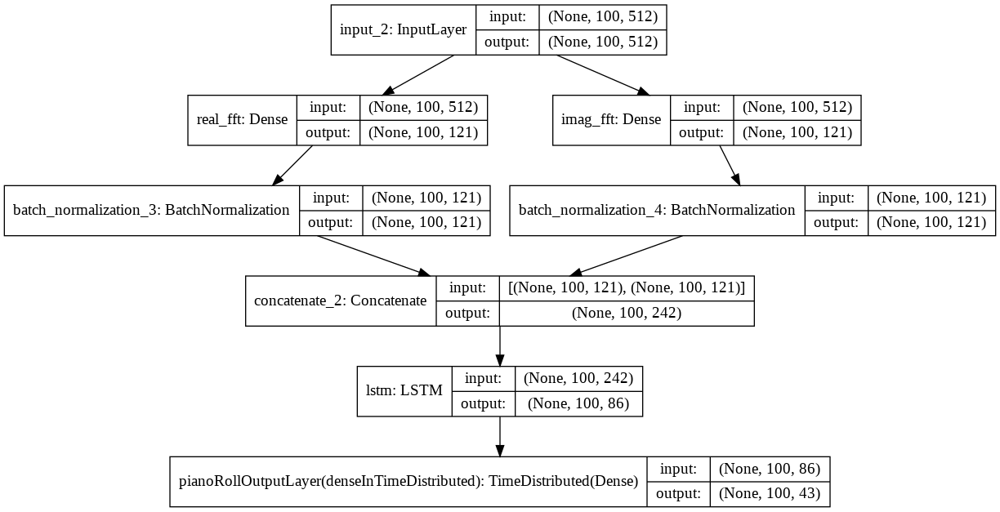

In [0]:
folderName = datetime.datetime.now().strftime("%Y%m%d_%H_%M_%S")
print("Will be saved as logs/tensorboard/{}".format(folderName))
tensorboard = TensorBoard(log_dir="logs/tensorboard/{}".format(folderName), histogram_freq=0, write_graph=True)





def pianoRollLoss(true, pred):
  eps = 1e-15
  predClip = K.clip(pred,eps,1-eps)
  loss = K.mean(-1 * K.sum(true * K.log(predClip) + (1.0-true) * K.log(1-predClip), axis = -1))
  return loss

losses = {
	"pianoRollOutputLayer": "kullback_leibler_divergence", # kind of multi class cross entropy los function
	"numNotesOutputLayer": "categorical_crossentropy",
}
lossWeights = {"pianoRollOutputLayer": 1000, "numNotesOutputLayer": 1}


def correct_exact_output(y_true, y_pred):
  return 1.0 - K.mean(K.max(K.abs(K.round(y_true) - K.round(y_pred)),-1))




metrics = {
	"pianoRollOutputLayer": ["binary_accuracy", correct_exact_output],
	"numNotesOutputLayer": ["categorical_accuracy", correct_exact_output ],
}

  
(input, pianoRollOutput, numNotesOutput) = trainGenerator.getSingleSample()

lr = 0.01


#inputLayer = Input(batch_shape = (batchSize, sampleSize, len(input)))
inputLayer = Input(batch_shape = (None, sampleSize, len(input)))
X = inputLayer
if not doFFT:
  
  #input is real, symmetry reasons,...
  #fftLen = 1 + int(sampleLength/2)
  fftLen = 121 # only up to ~8khz
  fftMatrix = scipy.linalg.dft(sampleLength, scale = "n")[:fftLen,:]
  realPartMatrix = np.real(fftMatrix)
  imagPartMatrix = np.imag(fftMatrix)
  mixedMatrix = np.zeros((2*fftLen, sampleLength))
  mixedMatrix[::2,:] = realPartMatrix
  mixedMatrix[1::2,:] = imagPartMatrix
  
  realFFTLayer = Dense(fftLen,trainable = False, use_bias = False, name = "real_fft" )
  
  #realFFTLayer.trainable = False
  
  imagFFTLayer = Dense(fftLen,trainable = False, use_bias = False, name = "imag_fft")

  #realFFTLayer.trainable = False

  
  realFFT = BatchNormalization()(realFFTLayer(X))
  imagFFT = BatchNormalization()(imagFFTLayer(X))
  
  #realFFT = Conv1D(filters = 2 * fftLen, kernel_size = 5, padding = "same", activation = "relu" )(realFFT)
  #imagFFT = Conv1D(filters = 2 * fftLen, kernel_size = 5, padding = "same", activation = "relu" )(imagFFT)
  
  X = Concatenate(axis=-1)([realFFT, imagFFT])
  
  
  
  
  
  
  
  #X = Dense(sampleLength,trainable = False, use_biaskernel_initializer = fftMatrix )(X)
  
  
  #X = Lambda(lambda x: tf.abs(tf.spectral.rfft(x)), name = "FFT")(X)
  #X = Lambda(lambda x: x[:,:,0:120], name = "only_120_bins__up_to_10_khz_with_512_length_samples")(X)
  
else:  
  X = Conv1D(filters = 43*2, kernel_size = 5, padding = "same", activation = "relu" )(X)
X = LSTM(units = 43*2, stateful = False, return_sequences = True, activation  = "tanh", name = "lstm")(X) # return_sequences so I can put another LSTM afterwards.
#x1 = LSTM(units = 43, stateful = False, return_sequences = True)(X) # return_sequences so I can put another LSTM afterwards.
#x2 = LSTM(units = 32, stateful = False, return_sequences = True)(X)
pianoRollOutputLayer = TimeDistributed(Dense(len(pianoRollOutput), activation = "sigmoid", name = "denseInTimeDistributed"), name = "pianoRollOutputLayer")(X)
#numNotesOutputLayer = TimeDistributed(Dense(len(numNotesOutput), activation = "softmax"), name = "numNotesOutputLayer")(x)

  


#model = Model(inputLayer, [pianoRollOutputLayer,numNotesOutputLayer])
model = Model(inputLayer, pianoRollOutputLayer)

realFFTLayer.set_weights([realPartMatrix.transpose()])
imagFFTLayer.set_weights([imagPartMatrix.transpose()])
  
  
#model.compile(loss=losses, loss_weights=lossWeights,	metrics=metrics, optimizer= optimizers.Adam(lr=lr))
model.compile(loss=pianoRollLoss, metrics=["categorical_accuracy", correct_exact_output ], optimizer= optimizers.Adam(lr=lr))

print(model.summary())

plot_model(model, show_shapes=True, show_layer_names=True, to_file='model.png')
Image(retina=True, filename='model.png')




#model.fit_generator(trainGenerator.generate(batchSize, sampleSize, returnNumNotes = False), \
#                    validation_data = validationGenerator.generate(batchSize, sampleSize, returnNumNotes = False),\
#                    validation_steps = 20, epochs = 10, steps_per_epoch = 60, callbacks=[tensorboard]  )



In [0]:
model.fit(x = train_data_data, y =train_data_labels, batch_size = 128, epochs = 20, validation_data = (validation_data_data, validation_data_labels), callbacks=[tensorboard]  )

Train on 10200 samples, validate on 2550 samples
Epoch 1/20
10200/10200 [==============================] - 24s 2ms/step - loss: 2.5170 - categorical_accuracy: 0.2648 - correct_exact_output: 0.3548 - val_loss: 3.5440 - val_categorical_accuracy: 0.1563 - val_correct_exact_output: 0.3323
Epoch 2/20
10200/10200 [==============================] - 23s 2ms/step - loss: 2.4250 - categorical_accuracy: 0.2878 - correct_exact_output: 0.3677 - val_loss: 3.4744 - val_categorical_accuracy: 0.1746 - val_correct_exact_output: 0.3391
Epoch 3/20
10200/10200 [==============================] - 23s 2ms/step - loss: 2.3310 - categorical_accuracy: 0.3112 - correct_exact_output: 0.3846 - val_loss: 3.4968 - val_categorical_accuracy: 0.1844 - val_correct_exact_output: 0.3508
Epoch 4/20
10200/10200 [==============================] - 24s 2ms/step - loss: 2.2661 - categorical_accuracy: 0.3191 - correct_exact_output: 0.3974 - val_loss: 3.4965 - val_categorical_accuracy: 0.1904 - val_correct_exact_output: 0.3539
Epo

In [0]:
# removes custom losses and metrics so TFJS will not complain about not knowing them.
model.compile(loss="mse", metrics=["categorical_accuracy" ], optimizer= optimizers.Adam(lr=lr))


modelPath = "model.h5"
model.save(modelPath)


from google.colab import files


In [0]:
K.clear_session() 
model = load_model(modelPath)
model.save(modelPath)

from google.colab import files
files.download(modelPath) 

In [0]:
%tensorboard --logdir logs/tensorboard


Reusing TensorBoard on port 6006 (pid 2074), started 3:12:02 ago. (Use '!kill 2074' to kill it.)

In [0]:
 #http://doc.ml.tu-berlin.de/bbci/material/publications/Bla_constQ.pdf

def getCqtMatrix(minMidiNum, maxMidiNum, fs, musicLength, binsPerMidiNum = 1):
  numBins = maxMidiNum-minMidiNum +1
  Q = 1.0/ (2**(1/numBins)-1)
  print("Q is " , Q)

  minFreq = librosa.core.midi_to_hz(minMidiNum)
  maxFreq = librosa.core.midi_to_hz(maxMidiNum)

  real_result = np.zeros((musicLength, numBins))
  imag_result = np.zeros((musicLength, numBins))

  for k in range(numBins):
    N = int(np.round( Q *fs / (minFreq* (2**((k)/numBins)))))
    if N > musicLength:
      raise Exception("Required filter length " + str(N) + " is longer than the music sample with length "  + str(musicLength) + " for frequency" + str(minFreq* (2**((k)/numBins)) ))
    startBin = int(np.floor((musicLength - N)/2))
    endBin = startBin + N
    coefficients = (np.hamming(N) * np.exp( -2*np.pi* 1j * Q * np.linspace(0,N-1, N) / N) / N)
    real_result[startBin:endBin,k] = np.real(coefficients)
    imag_result[startBin:endBin,k] = np.imag(coefficients)
  return (real_result, imag_result)

In [0]:
real_matrix, imag_matrix  = getCqtMatrix(72,72 + 12 * 2,44100, 4410)
print(cica.shape)


Q is  35.56968648322426
(4410, 25)
